In [1]:
import pandas as pd
from scipy.io import mmread
import scipy.sparse
import matplotlib.pyplot as plt

In [12]:
feature_matrix = mmread("../Data/FeatureMatrix.mtx")
genes = pd.read_csv("../Data/Genes.csv")
positions = pd.read_csv('../Data/SpotPositions.csv')
ScatterPies = pd.read_csv('../Data/SpotClusterMembership.csv')

In [4]:
expression_data = pd.DataFrame(feature_matrix, index=positions['barcode'], columns=genes['gene'])
expression_data

gene,Xkr4,Gm1992,Gm37381,Rp1,Sox17,Gm37323,Mrpl15,Lypla1,Gm37988,Tcea1,...,AC125149.1,AC125149.2,AC125149.4,AC234645.1,AC168977.2,AC168977.1,AC149090.1,CAAA01118383.1,Vmn2r122,CAAA01147332.1
barcode,,,,,,,,,,,,,,,,,,,,,
AAACAAGTATCTCCCA-1,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0
AAACACCAATAACTGC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0
AAACAGAGCGACTCCT-1,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
AAACAGGGTCTATATT-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AAACATTTCCCGGATT-1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTGTTGTGTGTCAAGA-1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
TTGTTTCACATCCAGG-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
TTGTTTCATTAGTCTA-1,1.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,5.0,...,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0


In [15]:
merged_df = pd.merge(positions, ScatterPies, on='barcode')
merged_df

,barcode,x,y,radius,X1,X2,X3,X4,X5,X6,X7,X8,X9
0,AAACAAGTATCTCCCA-1,12709.0,10806.0,71.192911,0.176596,0.130452,0.000000,0.277719,0.000000,0.334386,0.000000,0.000000,0.080847
1,AAACACCAATAACTGC-1,3616.0,12513.0,71.192911,0.000000,0.000000,0.000000,0.000000,0.662506,0.000000,0.193410,0.144084,0.000000
2,AAACAGAGCGACTCCT-1,11839.0,3944.0,71.192911,0.000000,0.000000,0.330006,0.000000,0.000000,0.250267,0.000000,0.163155,0.256573
3,AAACAGGGTCTATATT-1,2961.0,10225.0,71.192911,0.000000,0.087536,0.000000,0.000000,0.463777,0.000000,0.237417,0.131194,0.080076
4,AAACATTTCCCGGATT-1,12159.0,12902.0,71.192911,0.197194,0.216818,0.000000,0.126936,0.099019,0.067587,0.292446,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3494,TTGTTGTGTGTCAAGA-1,9974.0,7183.0,71.192911,0.077686,0.000000,0.109485,0.372448,0.095749,0.344632,0.000000,0.000000,0.000000
3495,TTGTTTCACATCCAGG-1,6136.0,12325.0,71.192911,0.055007,0.083465,0.134945,0.000000,0.208435,0.121374,0.000000,0.124215,0.272560
3496,TTGTTTCATTAGTCTA-1,4821.0,12705.0,71.192911,0.000000,0.067899,0.000000,0.000000,0.545618,0.000000,0.161659,0.148889,0.075935
3497,TTGTTTCCATACAACT-1,4495.0,9846.0,71.192911,0.000000,0.000000,0.221199,0.000000,0.171150,0.191596,0.000000,0.175395,0.240660


In [11]:
expression_data['Sox17'].value_counts()

Sox17
0.0    3358
1.0     135
2.0       6
Name: count, dtype: int64

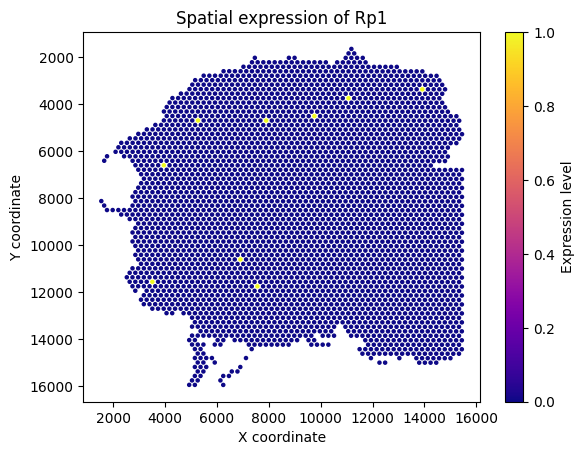

In [10]:
# Select a gene to visualize
gene_of_interest = 'Rp1'

# Create a scatter plot of the expression of the gene of interest
plt.scatter(positions['x'], positions['y'], c=expression_data[gene_of_interest], cmap='plasma', s=5)
plt.colorbar(label='Expression level')
plt.title(f'Spatial expression of {gene_of_interest}')
plt.xlabel('X coordinate')
plt.ylabel('Y coordinate')

plt.gca().invert_yaxis()
plt.show()

In [19]:
scale_factor = 500
merged_df['x_scaled'] = merged_df['x'] / scale_factor
merged_df['y_scaled'] = merged_df['y'] / scale_factor

# Plot setup
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_xlim(merged_df['x_scaled'].min() - 1, merged_df['x_scaled'].max() + 1)
ax.set_ylim(merged_df['y_scaled'].min() - 1, merged_df['y_scaled'].max() + 1)

# Plotting each pie chart
for _, row in merged_df.iterrows():
    sizes = [row['X1'], row['X2'], row['X3'], row['X4'], row['X5'], row['X6'], row['X7'], row['X8'], row['X9']]
    total = sum(sizes)
    if total > 0:  # Avoid plotting pie charts for rows where all sizes are zero
        sizes = [size / total for size in sizes]  # Normalize to sum to 1
    pie = ax.pie(sizes, center=(row['x_scaled'], row['y_scaled']), radius=row['radius'] / (scale_factor * 50), wedgeprops=dict(width=0.3, edgecolor='w'))  # Adjust radius scale if needed

# Adjusting plot appearance
ax.set_xlabel('X coordinate (scaled)')
ax.set_ylabel('Y coordinate (scaled)')
ax.set_title('Spatial expression with pie charts')
ax.invert_yaxis()  # Optional: depends on your coordinate system

# Show plot
plt.show()